<a href="https://colab.research.google.com/github/Tejas-MD/Anveshana/blob/main/DeepCAC_port_to_python_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [20]:
!pip install pynrrd
!pip install SimpleITK

In [21]:
!git clone https://github.com/AvantiShri/DeepCAC.git

Cloning into 'DeepCAC'...
remote: Enumerating objects: 527, done.
remote: Counting objects: 100% (432/432), done.
remote: Compressing objects: 100% (261/261), done.
remote: Total 527 (delta 297), reused 237 (delta 171), pack-reused 95 (from 1)
Receiving objects: 100% (527/527), 388.76 MiB | 16.34 MiB/s, done.
Resolving deltas: 100% (330/330), done.
Updating files: 100% (56/56), done.


In [22]:
%cd /content/DeepCAC/src
!ls

/content/DeepCAC/src
config				   run_step1_heart_localization.py  step1_heartloc
DeepCAC				   run_step2_heart_segmentation.py  step2_heartseg
model_without_weights_loaded.hdf5  run_step3_cac_segmentation.py    step3_cacseg
README.md			   run_step4_cac_scoring.py


In [23]:
!git pull

Already up to date.


In [24]:
!python run_step1_heart_localization.py

E0000 00:00:1742351744.310788    5382 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1742351744.323315    5382 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered

--- STEP 1 - HEART LOCALIZATION ---

Data preprocessing:
Found 4 patients under "/content/DeepCAC/data/raw"
Processing patient 0187
Processing patient 0909
Processing patient 0506
Processing patient 0987

Data downsampling:
Found 4 patients under "/content/DeepCAC/data/step1_heartloc/curated" folder.
Processing patient 0187
Processing patient 0506
Processing patient 0909
Processing patient 0987
Saving results dictionary...

Input data preparation:
Loading input data from "/content/DeepCAC/data/step1_heartloc/resampled"
Found 4 patients under "/content/DeepCAC/data/step1_heartloc/resampled" folder.
Writing data file... 
Processing patient 

In [25]:
import keras
from keras.saving import load_model

#from heartloc_model.py
def dice_coef(y_true, y_pred, smooth=1.):
  y_true_f = K.flatten(y_true)
  y_pred_f = K.flatten(y_pred)
  intersection = K.sum(y_true_f * y_pred_f)
  return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

## ----------------------------------------
## ----------------------------------------

def dice_coef_loss(y_true, y_pred):
  return -dice_coef(y_true, y_pred)


model_without_weights = load_model(
    "model_without_weights_loaded.hdf5",
    custom_objects={"dice_coef_loss": dice_coef_loss,
                    "dice_coef": dice_coef})

In [26]:
import tables
import pickle
import os
import numpy as np

#copied from https://github.com/AIM-Harvard/DeepCAC/blob/a1c2cd3b0ce082f047e042c1581b556ab08b0f77/src/step1_heartloc/run_inference.py#L68C3-L105C1
def get_input_data_to_model(dataDir, test_file, pkl_file, has_manual_seg, mgpu):
  testFileHdf5 = tables.open_file(os.path.join(dataDir, test_file), "r")
  pklData = pickle.load(open(os.path.join(dataDir, pkl_file), 'rb'))

  # Get data in one list for further processing
  testDataRaw = []
  num_test_imgs = len(testFileHdf5.root.ID)
  print(num_test_imgs)
  for i in range(num_test_imgs):
    patientID = (testFileHdf5.root.ID[i]).decode("utf-8") #python 2 to python 3 difference
    img = testFileHdf5.root.img[i]
    if has_manual_seg:
      msk = testFileHdf5.root.msk[i]
    else:  # Create empty dummy has_manual_seg with same size as the image
      sizeImg = len(img)
      msk = np.zeros((sizeImg, sizeImg, sizeImg), dtype=np.float64)
    print(pklData.keys())
    if not patientID in pklData.keys():
      print('Patient not found in pkl data', patientID)
      continue
    zDif = pklData[patientID][6][2]
    testDataRaw.append([patientID, img, msk, zDif])

  numData = len(testDataRaw)
  size = len(testDataRaw[0][1])
  imgsTrue = np.zeros((numData, size, size, size), dtype=np.float64)
  msksTrue = np.zeros((numData, size, size, size), dtype=np.float64)

  for i in range(0, len(testDataRaw) + 1, mgpu):
    imgTest = np.zeros((4, size, size, size), dtype=np.float64)

    for j in range(mgpu):
      # If the number of test images is not mod 4 == 0, just redo the last file severall times
      patientIndex = min(len(testDataRaw) - 1, i + j)
      patientID = testDataRaw[patientIndex][0]
      print('Processing patient', patientID)
      # Store data for score calculation
      imgsTrue[patientIndex, :, :, :] = testDataRaw[patientIndex][1]
      msksTrue[patientIndex, :, :, :] = testDataRaw[patientIndex][2]
      imgTest[j, :, :, :] = testDataRaw[patientIndex][1]

  return imgTest, msksTrue

input_data_to_model, inputMasks = get_input_data_to_model(
    dataDir="/content/DeepCAC/data/step1_heartloc/model_input", #model_input_dir_path
    test_file="step1_test_data.h5",
    pkl_file="step1_downsample_results.pkl",
    has_manual_seg=True,
    mgpu=1)


4
dict_keys(['0187', '0506', '0909', '0987'])
dict_keys(['0187', '0506', '0909', '0987'])
dict_keys(['0187', '0506', '0909', '0987'])
dict_keys(['0187', '0506', '0909', '0987'])
Processing patient 0187
Processing patient 0506
Processing patient 0909
Processing patient 0987
Processing patient 0987


In [27]:
inputMasks.shape

(4, 112, 112, 112)

In [28]:
model_preds_noweightsloaded = model_without_weights.predict(input_data_to_model[0:1])

1/1 ━━━━━━━━━━━━━━━━━━━━ 46s 46s/step


In [29]:
%matplotlib inline
from matplotlib import pyplot as plt

def sliceplot_z(np_array, ncols, stepsize, figsizepercol=4):
    plotdimlen = np_array.shape[2]
    numplots = int(plotdimlen/stepsize)
    nrows=int(np.ceil(numplots/ncols))
    fig, ax = plt.subplots(nrows=nrows,
                           ncols=ncols,
                           figsize=(ncols*figsizepercol,
                                    nrows*figsizepercol))
    for plotidx,i in enumerate(range(0, plotdimlen, stepsize)):
        plt.sca(ax[int(plotidx/ncols), plotidx%ncols])
        plt.imshow(np_array[:,:,i])
        plt.title("z="+str(i))
    plt.show()



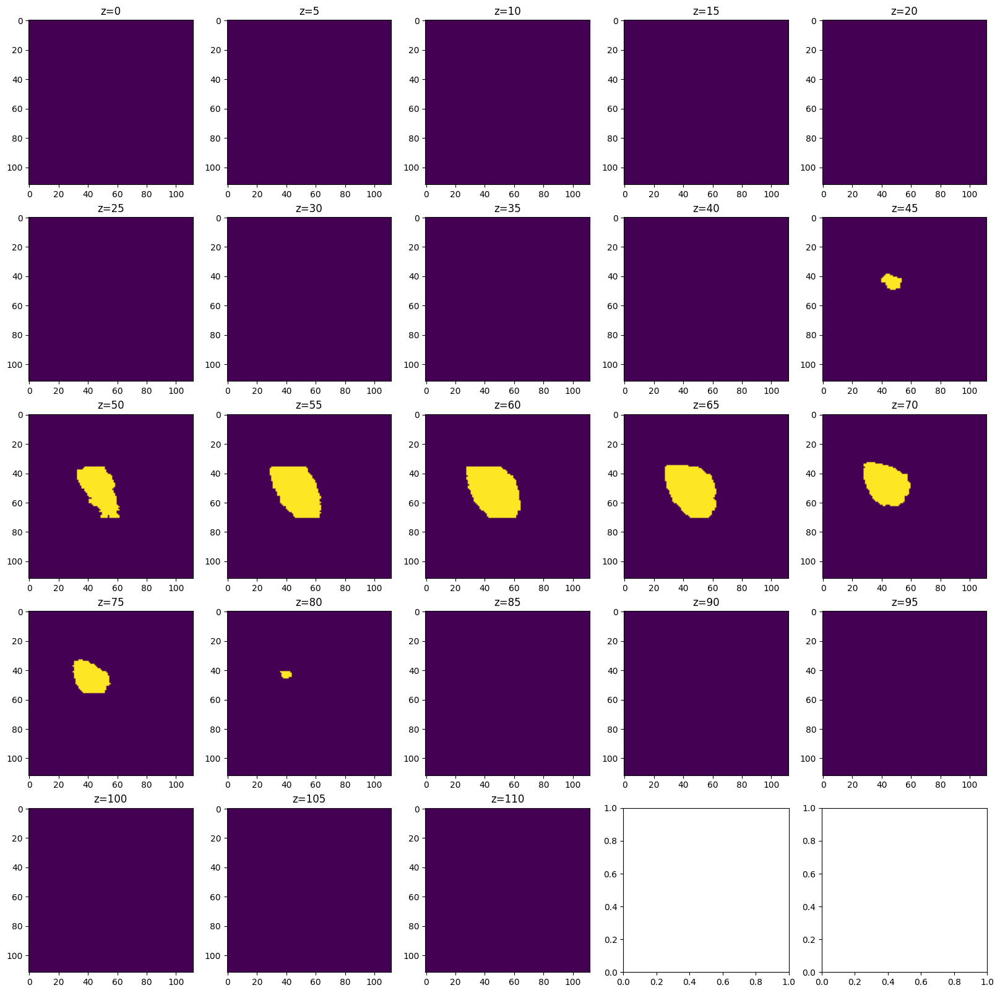

In [30]:
sliceplot_z(inputMasks[0], ncols=5, stepsize=5)

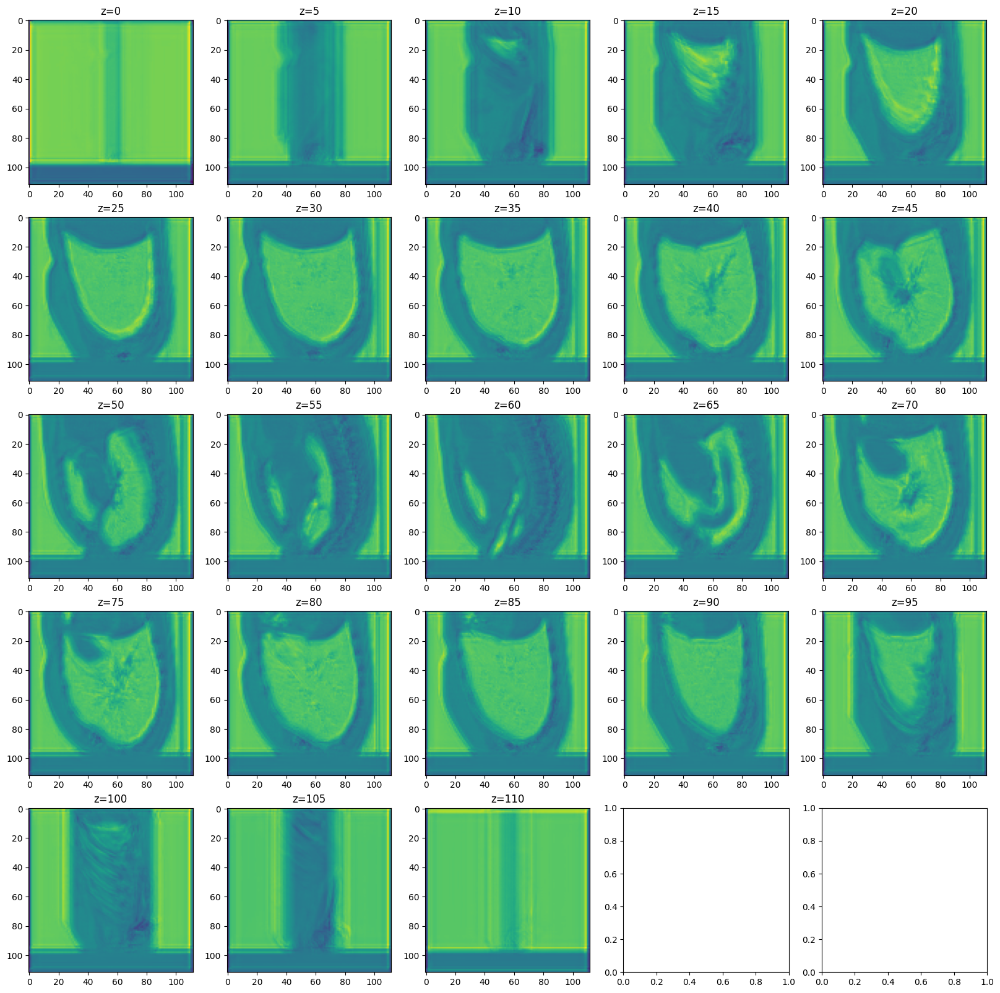

In [31]:
sliceplot_z(model_preds_noweightsloaded[0].squeeze(), ncols=5, stepsize=5)

In [32]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [33]:
#Loading the weights from hdf5 to npy
import h5py
import numpy as np
f = h5py.File("/content/DeepCAC/data/step1_heartloc/model_weights/step1_heartloc_model_weights.hdf5", "r")
f['model_1'].keys()

<KeysViewHDF5 ['conv_10', 'conv_1_1', 'conv_1_2', 'conv_2_1', 'conv_2_2', 'conv_3_1', 'conv_3_2', 'conv_4_1', 'conv_4_2', 'conv_5_1', 'conv_5_2', 'conv_6_1', 'conv_6_2', 'conv_7_1', 'conv_7_2', 'conv_8_1', 'conv_8_2', 'conv_9_1', 'conv_9_2']>

Loaded the weights for model 1.
There are some layers with no weights. Not sure why.
Try:

In [34]:
model_without_weights.layers[3].name

'pool_1'

In [35]:
#setting the weights of each layer
conv_1_1_b = np.array(f['model_1']['conv_1_1']['bias:0'])
conv_1_1_k = np.array(f['model_1']['conv_1_1']['kernel:0'])
model_without_weights.layers[1].set_weights([conv_1_1_k, conv_1_1_b])
conv_1_2_b = np.array(f['model_1']['conv_1_2']['bias:0'])
conv_1_2_k = np.array(f['model_1']['conv_1_2']['kernel:0'])
model_without_weights.layers[2].set_weights([conv_1_2_k, conv_1_2_b])
conv_2_1_b = np.array(f['model_1']['conv_2_1']['bias:0'])
conv_2_1_k = np.array(f['model_1']['conv_2_1']['kernel:0'])
model_without_weights.layers[4].set_weights([conv_2_1_k, conv_2_1_b])
conv_2_2_b = np.array(f['model_1']['conv_2_2']['bias:0'])
conv_2_2_k = np.array(f['model_1']['conv_2_2']['kernel:0'])
model_without_weights.layers[5].set_weights([conv_2_2_k, conv_2_2_b])
conv_3_1_b = np.array(f['model_1']['conv_3_1']['bias:0'])
conv_3_1_k = np.array(f['model_1']['conv_3_1']['kernel:0'])
model_without_weights.layers[7].set_weights([conv_3_1_k, conv_3_1_b])
conv_3_2_b = np.array(f['model_1']['conv_3_2']['bias:0'])
conv_3_2_k = np.array(f['model_1']['conv_3_2']['kernel:0'])
model_without_weights.layers[8].set_weights([conv_3_2_k, conv_3_2_b])
conv_4_1_b = np.array(f['model_1']['conv_4_1']['bias:0'])
conv_4_1_k = np.array(f['model_1']['conv_4_1']['kernel:0'])
model_without_weights.layers[10].set_weights([conv_4_1_k, conv_4_1_b])
conv_4_2_b = np.array(f['model_1']['conv_4_2']['bias:0'])
conv_4_2_k = np.array(f['model_1']['conv_4_2']['kernel:0'])
model_without_weights.layers[11].set_weights([conv_4_2_k, conv_4_2_b])
conv_5_1_b = np.array(f['model_1']['conv_5_1']['bias:0'])
conv_5_1_k = np.array(f['model_1']['conv_5_1']['kernel:0'])
model_without_weights.layers[13].set_weights([conv_5_1_k, conv_5_1_b])
conv_5_2_b = np.array(f['model_1']['conv_5_2']['bias:0'])
conv_5_2_k = np.array(f['model_1']['conv_5_2']['kernel:0'])
model_without_weights.layers[14].set_weights([conv_5_2_k, conv_5_2_b])
conv_6_1_b = np.array(f['model_1']['conv_6_1']['bias:0'])
conv_6_1_k = np.array(f['model_1']['conv_6_1']['kernel:0'])
model_without_weights.layers[17].set_weights([conv_6_1_k, conv_6_1_b])
conv_6_2_b = np.array(f['model_1']['conv_6_2']['bias:0'])
conv_6_2_k = np.array(f['model_1']['conv_6_2']['kernel:0'])
model_without_weights.layers[18].set_weights([conv_6_2_k, conv_6_2_b])
conv_7_1_b = np.array(f['model_1']['conv_7_1']['bias:0'])
conv_7_1_k = np.array(f['model_1']['conv_7_1']['kernel:0'])
model_without_weights.layers[21].set_weights([conv_7_1_k, conv_7_1_b])
conv_7_2_b = np.array(f['model_1']['conv_7_2']['bias:0'])
conv_7_2_k = np.array(f['model_1']['conv_7_2']['kernel:0'])
model_without_weights.layers[22].set_weights([conv_7_2_k, conv_7_2_b])
conv_8_1_b = np.array(f['model_1']['conv_8_1']['bias:0'])
conv_8_1_k = np.array(f['model_1']['conv_8_1']['kernel:0'])
model_without_weights.layers[25].set_weights([conv_8_1_k, conv_8_1_b])
conv_8_2_b = np.array(f['model_1']['conv_8_2']['bias:0'])
conv_8_2_k = np.array(f['model_1']['conv_8_2']['kernel:0'])
model_without_weights.layers[26].set_weights([conv_8_2_k, conv_8_2_b])
conv_9_1_b = np.array(f['model_1']['conv_9_1']['bias:0'])
conv_9_1_k = np.array(f['model_1']['conv_9_1']['kernel:0'])
model_without_weights.layers[29].set_weights([conv_9_1_k, conv_9_1_b])
conv_9_2_b = np.array(f['model_1']['conv_9_2']['bias:0'])
conv_9_2_k = np.array(f['model_1']['conv_9_2']['kernel:0'])
model_without_weights.layers[30].set_weights([conv_9_2_k, conv_9_2_b])
conv_10_b = np.array(f['model_1']['conv_10']['bias:0'])
conv_10_k = np.array(f['model_1']['conv_10']['kernel:0'])
model_without_weights.layers[31].set_weights([conv_10_k, conv_10_b])

#make sure input_data_to_model is prepared befor this point
model_preds_weightsloaded = model_without_weights.predict(input_data_to_model[0:1])
model = model_without_weights


1/1 ━━━━━━━━━━━━━━━━━━━━ 43s 43s/step


In [36]:
#saving the new model with the weights
import os
import tensorflow as tf
from tensorflow import keras
model.save('step1_model_w_weights.keras') # Saves the entire model as a `.keras` zip archive.


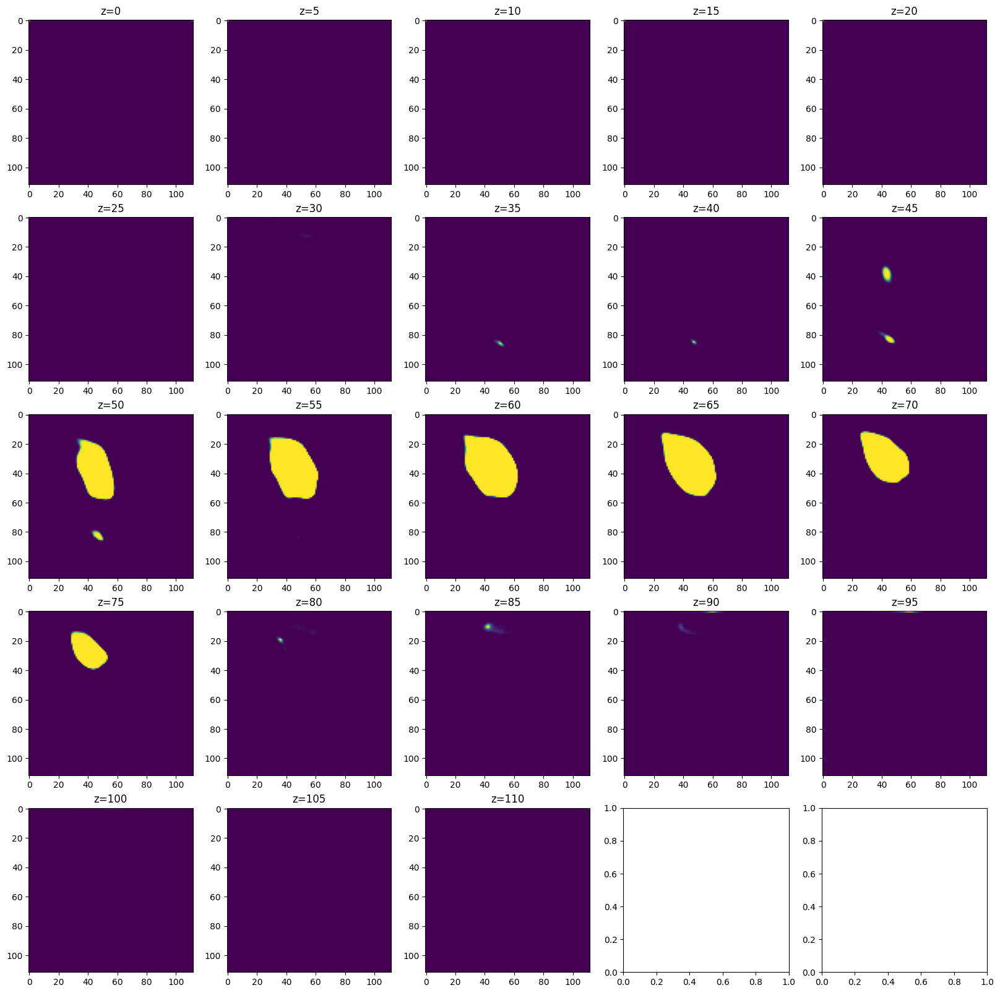

In [37]:
sliceplot_z(model_preds_weightsloaded[0].squeeze(), ncols=5, stepsize=5)

In [52]:
import os
import numpy as np
import pickle
import tables
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv3D, MaxPooling3D, UpSampling3D, concatenate, Lambda
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

##########################################
# Model Definition with Dynamic Shapes
##########################################

def custom_lambda_layer(x):
    # Use dynamic shape computation instead of x.shape.as_list()
    dynamic_shape = tf.shape(x)
    # For demonstration, we simply return x. Modify as needed.
    return x

def get_unet_3d_4(input_shape, pool_size=(2,2,2), conv_size=3, n_filters=16):
    inputs = Input(shape=input_shape)

    # Example: Apply a Lambda layer that uses dynamic shape functions.
    x = Lambda(custom_lambda_layer)(inputs)

    # Build a simple U-Net-like structure (this is an example).
    conv1 = Conv3D(n_filters, conv_size, activation='relu', padding='same')(x)
    pool1 = MaxPooling3D(pool_size=pool_size)(conv1)
    up1 = UpSampling3D(size=pool_size)(pool1)
    concat1 = concatenate([conv1, up1])
    outputs = Conv3D(1, 1, activation='sigmoid')(concat1)

    model = Model(inputs=inputs, outputs=outputs)
    return model

##########################################
# Inference Code
##########################################

# Define paths and settings
dataDir = "/content/DeepCAC/data/step1_heartloc/model_input"  # model_input_dir_path
test_file = "step1_test_data.h5"
pkl_file = "step1_downsample_results.pkl"
has_manual_seg = True
mgpu = 1
model_output_dir_path = "/content/DeepCAC/data/step1_heartloc/model_output"

# Create the model with a fully specified input shape (112,112,112,1)
input_shape = (112, 112, 112, 1)
model = get_unet_3d_4(input_shape)
initial_learning_rate = 1e-5
model.compile(optimizer=Adam(learning_rate=initial_learning_rate), loss='binary_crossentropy')

# Open the HDF5 file and load pickle data
testFileHdf5 = tables.open_file(os.path.join(dataDir, test_file), "r")
pklData = pickle.load(open(os.path.join(dataDir, pkl_file), 'rb'))

# Process test data into a list
testDataRaw = []
num_test_imgs = len(testFileHdf5.root.ID)
print(num_test_imgs)
for i in range(num_test_imgs):
    patientID = (testFileHdf5.root.ID[i]).decode("utf-8")  # handle python2-to-3 difference
    img = testFileHdf5.root.img[i]
    if has_manual_seg:
        msk = testFileHdf5.root.msk[i]
    else:
        sizeImg = len(img)
        msk = np.zeros((sizeImg, sizeImg, sizeImg), dtype=np.float64)
    print(pklData.keys())
    if patientID not in pklData.keys():
        print('Patient not found in pkl data', patientID)
        continue
    zDif = pklData[patientID][6][2]
    testDataRaw.append([patientID, img, msk, zDif])

# Prepare arrays for images and masks
numData = len(testDataRaw)
size = len(testDataRaw[0][1])
imgsTrue = np.zeros((numData, size, size, size), dtype=np.float64)
msksTrue = np.zeros((numData, size, size, size), dtype=np.float64)

for i in range(len(testDataRaw)):
    imgsTrue[i, :, :, :] = testDataRaw[i][1]
    msksTrue[i, :, :, :] = testDataRaw[i][2]

# Add an extra channel dimension: imgsTrue becomes (numData, size, size, size, 1)
imgsTrue = imgsTrue[..., np.newaxis]

# Perform prediction.
msksPred = model.predict(imgsTrue)

# Save the results using np.savez to handle arrays of different shapes.
output_dir_npy = os.path.join(model_output_dir_path, 'npy')
if not os.path.exists(output_dir_npy):
    os.makedirs(output_dir_npy)
for patientIndex in range(len(testDataRaw)):
    patientID = testDataRaw[patientIndex][0]
    np.savez(os.path.join(output_dir_npy, patientID + '_pred.npz'),
             img=imgsTrue[patientIndex],
             msk=msksTrue[patientIndex],
             pred=msksPred[patientIndex, :, :, :, 0])


4
dict_keys(['0187', '0506', '0909', '0987'])
dict_keys(['0187', '0506', '0909', '0987'])
dict_keys(['0187', '0506', '0909', '0987'])
dict_keys(['0187', '0506', '0909', '0987'])
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


Input image


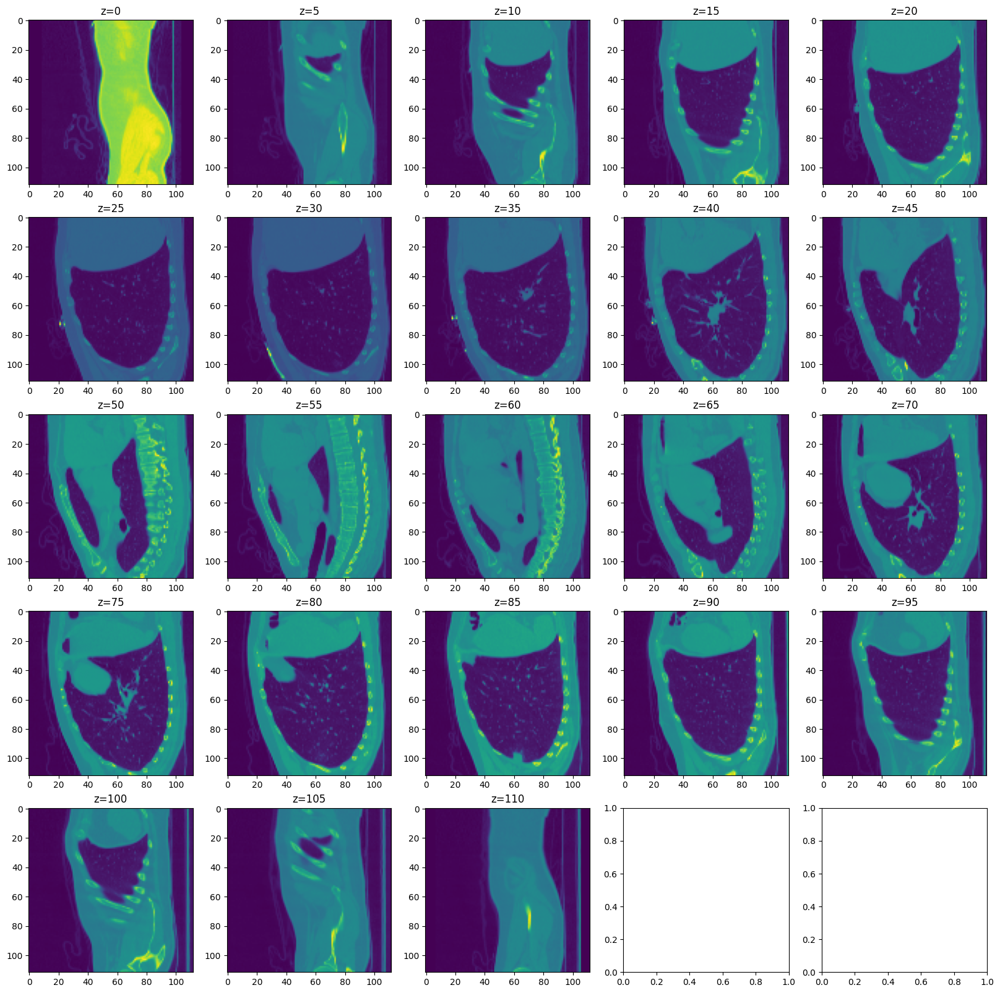

Prediction


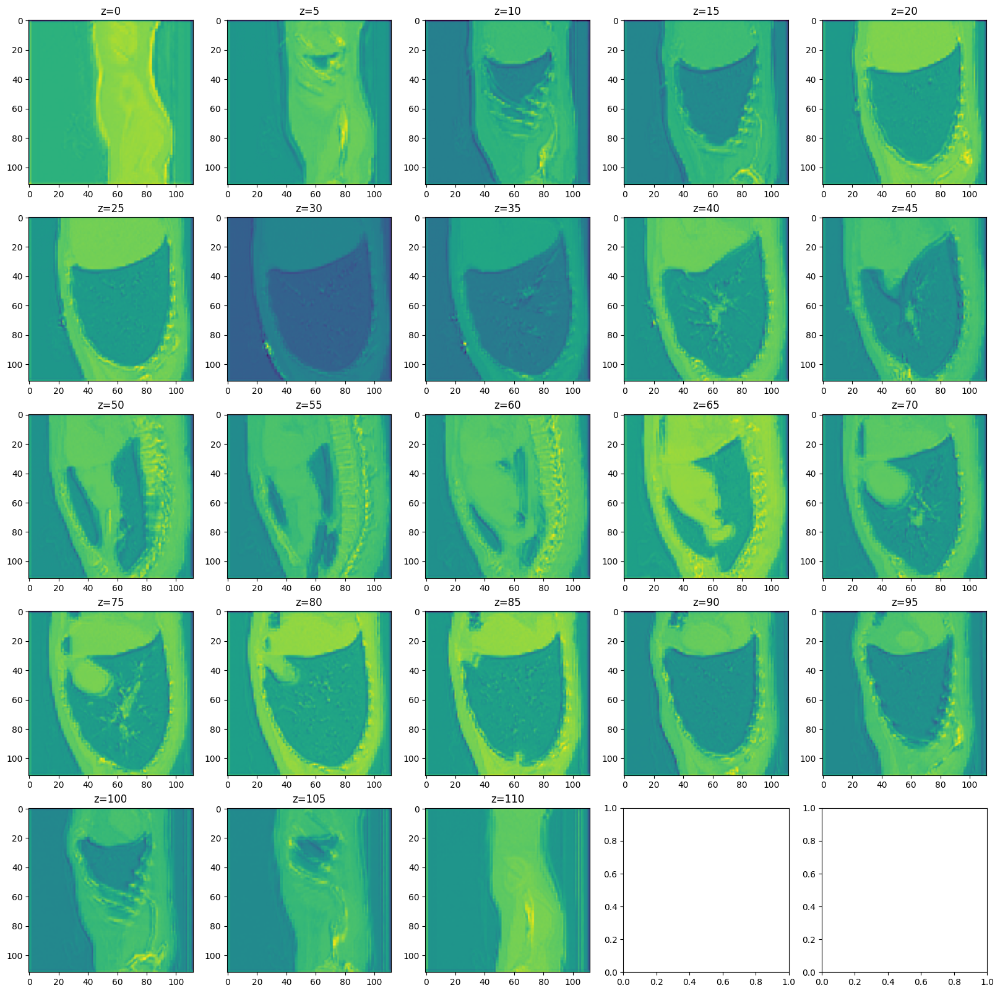

Input image


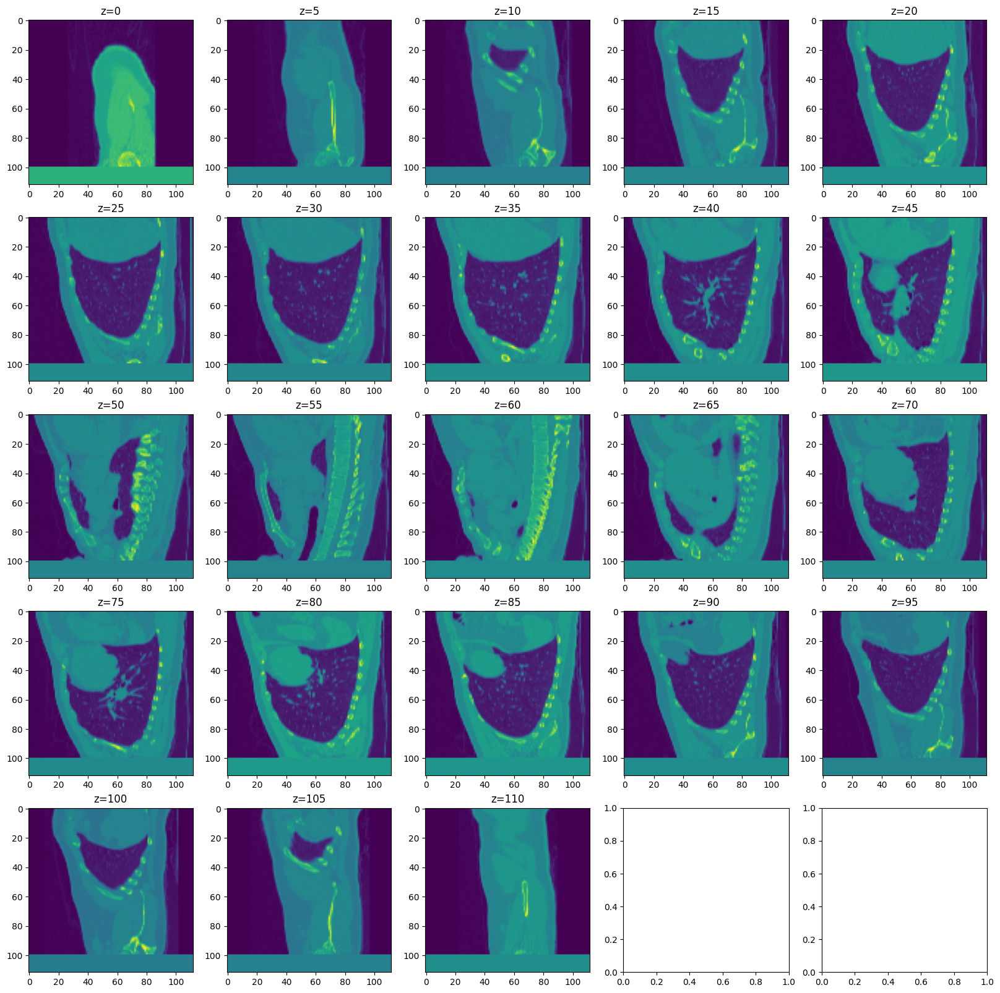

Prediction


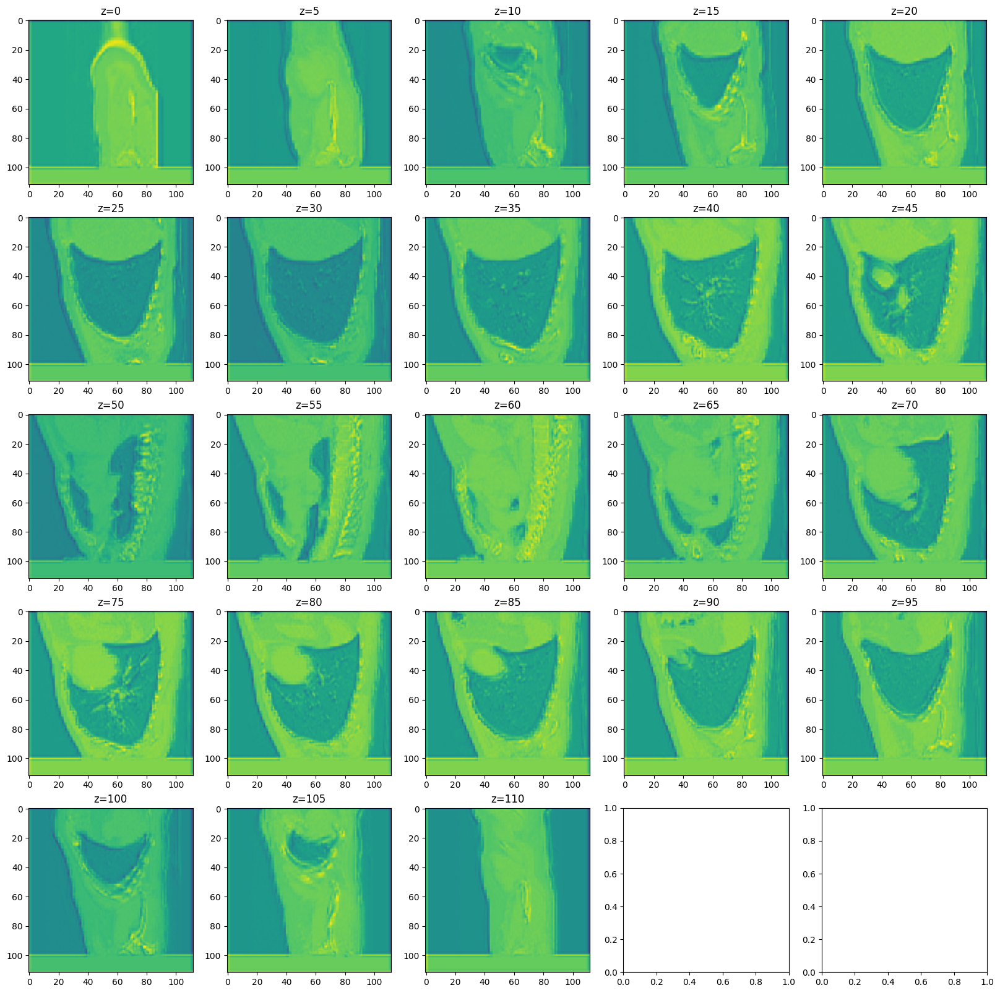

Input image


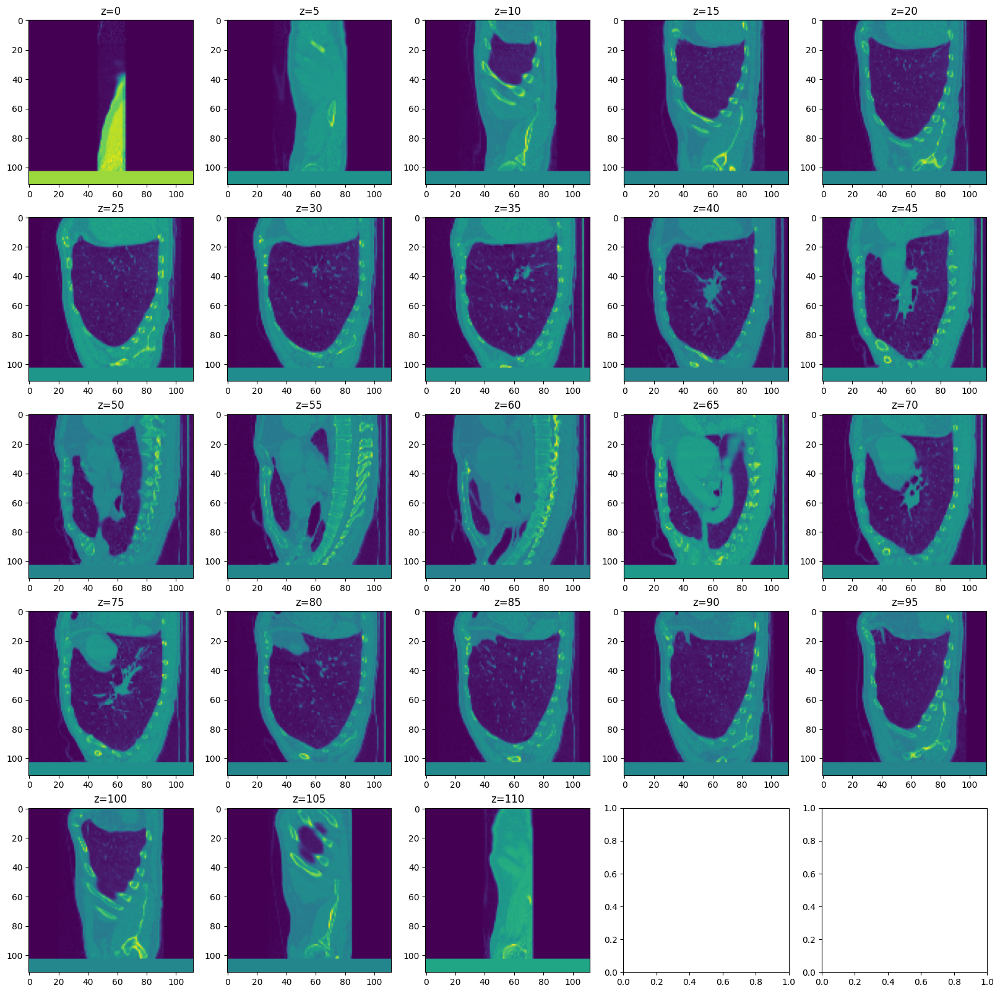

Prediction


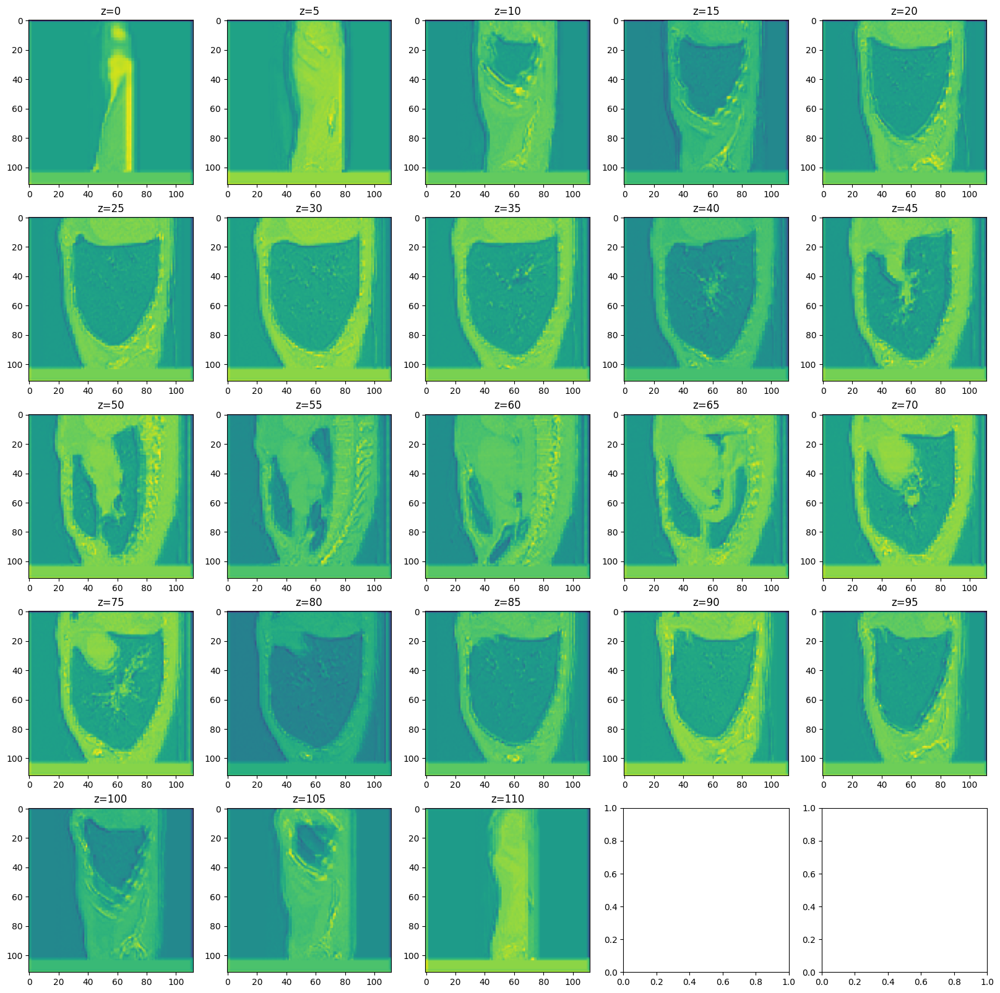

Input image


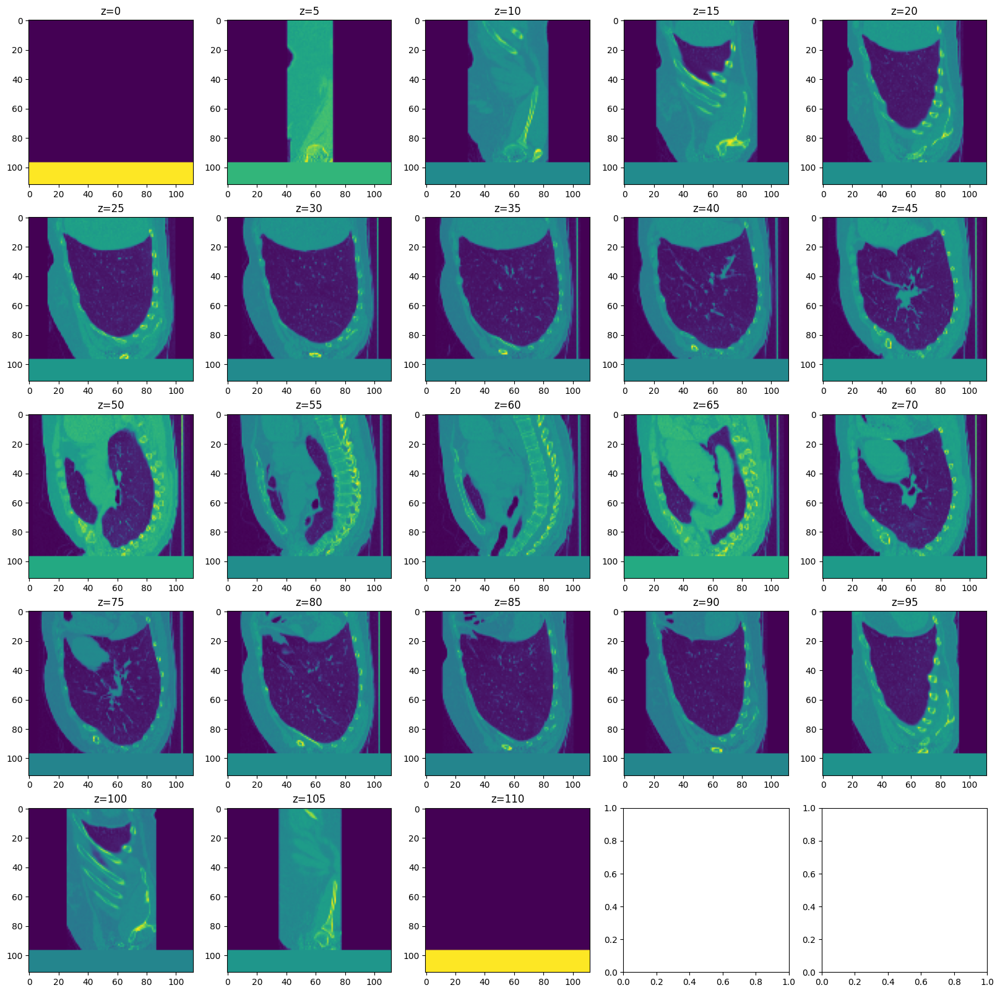

Prediction


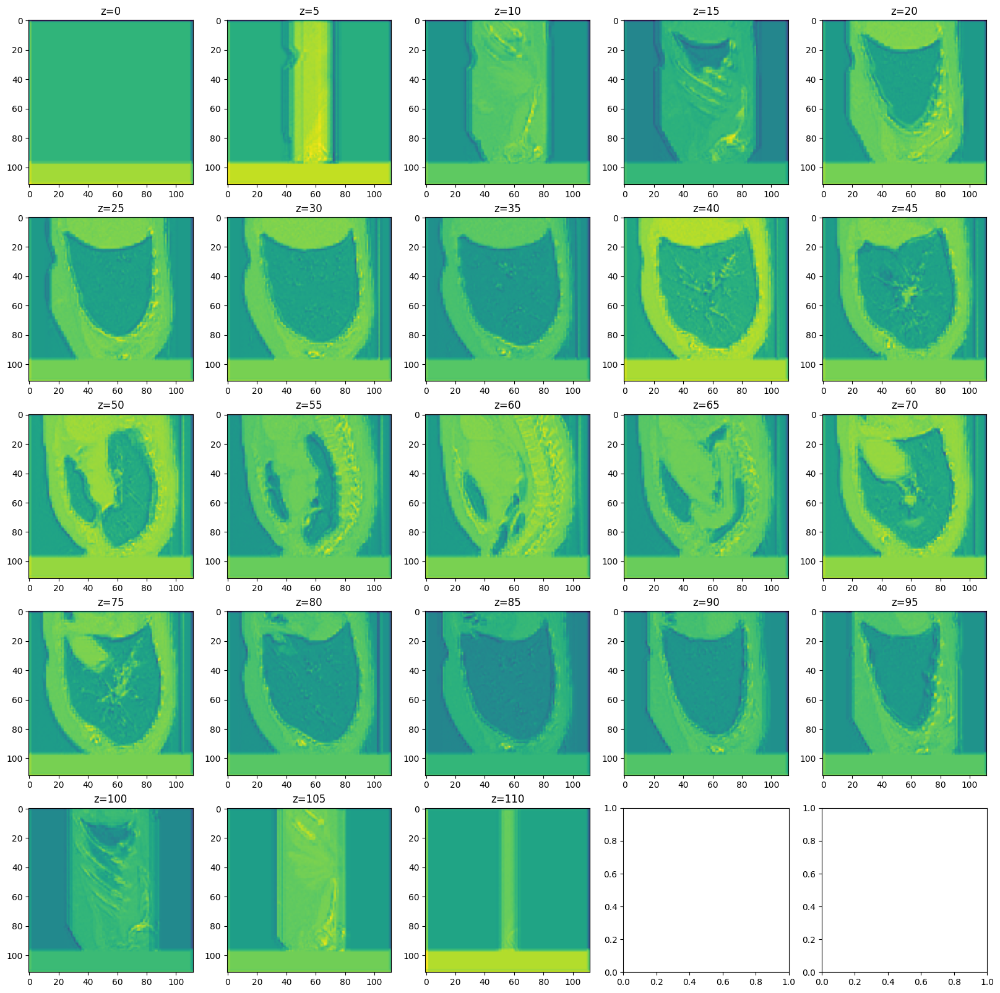

In [54]:
#visualize inputs and output for the 4 images
for i in range(4):
  print("Input image")
  sliceplot_z(imgsTrue[i], ncols=5, stepsize=5)
  print("Prediction")
  sliceplot_z(msksPred[i], ncols=5, stepsize=5)

In [55]:
output_dir_npy

'/content/DeepCAC/data/step1_heartloc/model_output/npy'

In [56]:
!ls {output_dir_npy}

0187_pred.npy  0187_pred.npz  0506_pred.npz  0909_pred.npz  0987_pred.npz


In [57]:
#code from the 'upsample results' part:
import yaml
import os
yaml_conf = yaml.load(open("/content/DeepCAC/src/config/step1_heart_localization.yaml"),
                      Loader = yaml.FullLoader)
data_folder_path = data_folder_path = os.path.normpath(yaml_conf["io"]["path_to_data_folder"])
heartloc_data_folder_name = yaml_conf["io"]["heartloc_data_folder_name"]
curated_data_folder_name = yaml_conf["io"]["curated_data_folder_name"]
resampled_data_folder_name = yaml_conf["io"]["resampled_data_folder_name"]
upsampled_data_folder_name = yaml_conf["io"]["upsampled_data_folder_name"]
heartloc_data_path = os.path.join(data_folder_path, heartloc_data_folder_name)
curated_dir_path = os.path.join(heartloc_data_path, curated_data_folder_name)
resampled_dir_path = os.path.join(heartloc_data_path, resampled_data_folder_name)
model_output_nrrd_dir_path = os.path.join(heartloc_data_path, upsampled_data_folder_name)
num_cores = 1;

#try to then import the upsample_results function from
# https://github.com/AIM-Harvard/DeepCAC/blob/main/src/step1_heartloc/upsample_results.py
#and call it with the values above

In [58]:
%cd /content/DeepCAC/src/step1_heartloc

/content/DeepCAC/src/step1_heartloc


In [59]:
!git pull

Already up to date.


In [90]:
import sys
from importlib import reload
sys.path.append("/content/DeepCAC/src/")
from step1_heartloc import upsample_results
reload(upsample_results)

model_output_dir_path = "/content/DeepCAC/data/step1_heartloc/model_output"
upsample_results.upsample_results(curated_dir_path, resampled_dir_path, model_output_dir_path, model_output_nrrd_dir_path, num_cores)

#!python upsample_results.py



Data upsampling:
Found 4 patients under "/content/DeepCAC/data/step1_heartloc/curated"
Processing patient 0187
Processing patient 0506
Processing patient 0909
Processing patient 0987


In [91]:
!ls {model_output_nrrd_dir_path}

0187_pred.nrrd	0506_pred.nrrd	0909_pred.nrrd	0987_pred.nrrd


In [92]:
print([[patientID],
       imgsTrue[patientIndex].shape,
       msksTrue[patientIndex].shape,
       msksPred[patientIndex, :, :, :, 0].shape])

[['0987'], (112, 112, 112, 1), (112, 112, 112), (112, 112, 112)]


In [93]:
np.savez(os.path.join(output_dir_npy, patientID + '_pred.npz'),
         patientID=patientID,
         img=imgsTrue[patientIndex],
         msk=msksTrue[patientIndex],
         pred=msksPred[patientIndex, :, :, :, 0])

In [94]:
def get_input_data_and_make_pred(dataDir, test_file, pkl_file, has_manual_seg, mgpu, model_output_dir_path, model):
    import os
    import numpy as np
    import pickle
    import tables
    import tensorflow as tf

    # Open HDF5 and pickle files.
    testFileHdf5 = tables.open_file(os.path.join(dataDir, test_file), "r")
    pklData = pickle.load(open(os.path.join(dataDir, pkl_file), 'rb'))

    # Get data in one list for further processing.
    testDataRaw = []
    num_test_imgs = len(testFileHdf5.root.ID)
    print(num_test_imgs)
    for i in range(num_test_imgs):
        patientID = (testFileHdf5.root.ID[i]).decode("utf-8")  # python 2 -> 3 difference
        img = testFileHdf5.root.img[i]
        if has_manual_seg:
            msk = testFileHdf5.root.msk[i]
        else:
            sizeImg = len(img)
            msk = np.zeros((sizeImg, sizeImg, sizeImg), dtype=np.float64)
        print(pklData.keys())
        if patientID not in pklData.keys():
            print('Patient not found in pkl data', patientID)
            continue
        zDif = pklData[patientID][6][2]
        testDataRaw.append([patientID, img, msk, zDif])

    # Prepare arrays for images and masks.
    numData = len(testDataRaw)
    size = len(testDataRaw[0][1])
    imgsTrue = np.zeros((numData, size, size, size), dtype=np.float64)
    msksTrue = np.zeros((numData, size, size, size), dtype=np.float64)

    # Loop in batches of mgpu (here mgpu is the batch size for prediction)
    for i in range(0, len(testDataRaw), mgpu):
        # Create a temporary batch for prediction.
        # Here we allocate an array for mgpu images.
        imgTest = np.zeros((mgpu, size, size, size), dtype=np.float64)

        # Loop over each element in the batch.
        for j in range(mgpu):
            patientIndex = min(len(testDataRaw) - 1, i + j)
            patientID = testDataRaw[patientIndex][0]
            print('Processing patient', patientID)
            # Save ground-truth image and mask.
            imgsTrue[patientIndex, :, :, :] = testDataRaw[patientIndex][1]
            msksTrue[patientIndex, :, :, :] = testDataRaw[patientIndex][2]
            # Fill in the batch for prediction.
            imgTest[j, :, :, :] = testDataRaw[patientIndex][1]

        # Force the model to know its full input shape by building with a fixed batch size.
        # We add an extra channel dimension so the input shape becomes (mgpu, size, size, size, 1)
        model.build((mgpu, size, size, size, 1))

        # Optional: run a dummy prediction to force shape inference.
        dummy_input = np.zeros((mgpu, size, size, size, 1), dtype=np.float64)
        try:
            _ = model.predict(dummy_input)
        except Exception as e:
            print("Dummy prediction error (can be ignored if prediction works later):", e)

        # Run prediction on the batch.
        msksPred = model.predict(imgTest[:, :, :, :, np.newaxis])

        # Ensure output directory exists.
        output_dir_npy = os.path.join(model_output_dir_path, 'npy')
        if not os.path.exists(output_dir_npy):
            os.makedirs(output_dir_npy)

        # Save each prediction using np.savez, which can store heterogeneous arrays.
        for j in range(mgpu):
            patientIndex = min(len(testDataRaw) - 1, i + j)
            patientID = testDataRaw[patientIndex][0]
            np.savez(os.path.join(output_dir_npy, patientID + '_pred.npz'),
                     patientID=patientID,
                     img=imgsTrue[patientIndex],
                     msk=msksTrue[patientIndex],
                     pred=msksPred[j, :, :, :, 0])


In [95]:
model_preds = model_without_weights.predict(input_data_to_model[0:1])


1/1 ━━━━━━━━━━━━━━━━━━━━ 45s 45s/step


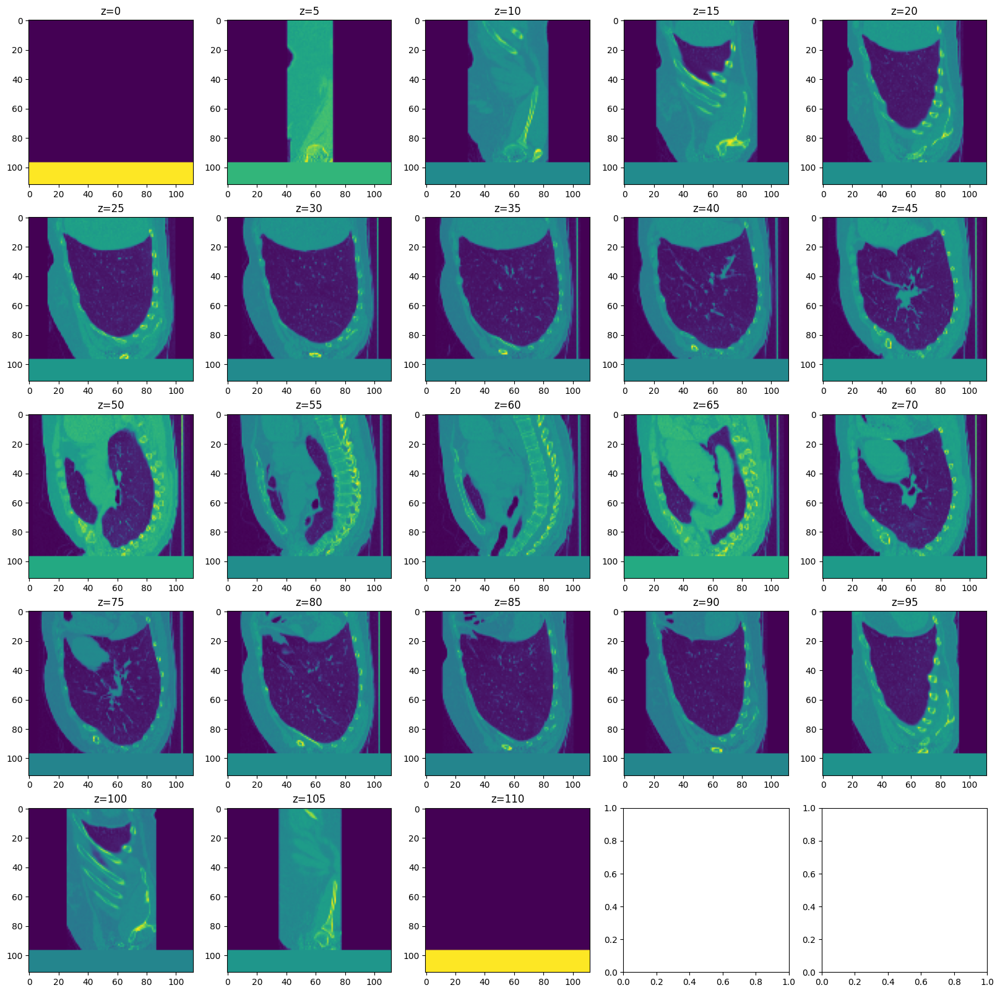

In [96]:
sliceplot_z(input_data_to_model[0], ncols=5, stepsize=5)

For visualizing input data:

(512, 512, 143)


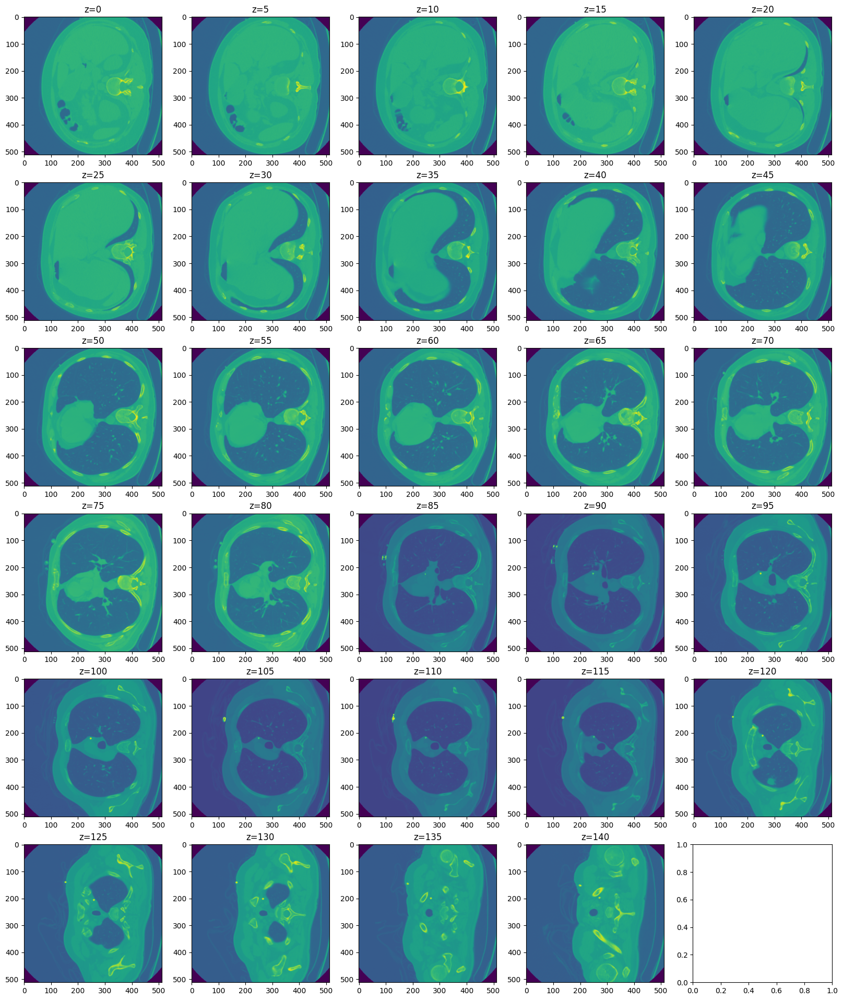

In [97]:
import numpy as np
import nrrd
readdata, header = nrrd.read('/content/DeepCAC/data/raw/0187/img.nrrd')
print(readdata.shape)
sliceplot_z(readdata, ncols=5, stepsize=5)

In [98]:
!pip install SimpleITK

Step 2 Code

In [99]:
!git pull

Already up to date.


In [100]:
%cd /content/DeepCAC/src

/content/DeepCAC/src


In [101]:
!python run_step2_heart_segmentation.py

E0000 00:00:1742354516.661535   16945 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1742354516.680525   16945 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered

--- STEP 2 - HEART SEGMENTATION ---

Bounding box calculation:
Found 4 images under "../data/step1_heartloc/curated"
Loading the masks inferred on step1 for 4 patients under "../data/step1_heartloc/model_output_nrrd"

Data cropping:
Found results for 4 patients in "../data/step2_heartseg/bbox/bbox.pkl"
Processing patient 0187
Processing patient 0506
Processing patient 0909
Processing patient 0987
Saving 4 patients data to "../data/step2_heartseg/model_input/diff_result.pkl"

Input data preparation:
Loading input data from "../data/step2_heartseg/cropped"
Found 4 patients
Preprocess data
Process patient 0187
Process patient 0506
Process pa

In [102]:
!python run_step3_cac_segmentation.py

E0000 00:00:1742354541.727153   17122 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1742354541.734558   17122 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered

--- STEP 3 - CAC SEGMENTATION ---

Segmentation masks dilation:
Found 0 patients under "../data/step2_heartseg/model_output_nrrd"

Heart cropping:
Found 0 files under "../data/step3_cacseg/dilated"

Deep Learning model inference using 4xGPUs:
Found 0 patients under "../data/step3_cacseg/cropped"
Loading saved model from "../data/step3_cacseg/model_weights/step3_cacseg_model_weights.hdf5"
Traceback (most recent call last):
  File "/content/DeepCAC/src/run_step3_cac_segmentation.py", line 154, in <module>
    run_inference.run_inference(data_dir = cropped_dir_name,
  File "/content/DeepCAC/src/step3_cacseg/run_inference.py", line 210, in ru